# Pre Entrega TP 1 - Lucas Tomasini

In [36]:
# Para visuzalización en notebook
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (8,6)
mpl.rcParams['font.size'] = 22
from IPython.display import Audio, Markdown, Image
import seaborn as sns

# Clustering
from scipy.cluster.hierarchy import dendrogram, linkage, cophenet, fcluster

# Números y Datos
import numpy as np
import pandas as pd
import ast # To convert single to double quotes

# Archivos
import urllib.request
import glob
import os

# Machine learning
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import adjusted_rand_score

## Carga metadata

In [37]:
# Funcion utilizada por read_csv para procesar el archivo metadata.csv
def process_album(val):
    d = ast.literal_eval(val)
    year = d["release_date"].split("-")[0]

    return d["name"] + "," + year

In [38]:
# A la columna "album" le aplico la funcion process_album para filtrar unicamente el nombre y año del album
metadata = pd.read_csv('data/metadata.csv', index_col='id', converters={"album": process_album})

In [39]:
# Bajar zip con los datos de audio_analysis
#urllib.request.urlretrieve('https://www.dropbox.com/s/gldffl4k2fmgo70/audio_analysis.zip?dl=1','data/audio_analysis.zip')
#!unzip -qq -o -d data  data/audio_analysis.zip 

In [40]:
# Separo titulo y año del campo album en dos columnas distintas
title_and_year = metadata["album"].str.split(",", n = 1, expand = True) 
  
metadata["album"]= title_and_year[0] 
metadata["year"]= title_and_year[1] # creo nuevo campo para el año 

In [41]:
metadata = metadata.loc[:, ["name", "album","artists", "genre", "year"]]
metadata.head()

,name,album,artists,genre,year
id,,,,,
5i2sgqnzaxYpvXmGAB592h,Corcovado - Quiet Nights Of Quiet Stars,Getz/Gilberto (Classics International Version),Stan Getz,jazz,1964
4mGzm5ahHxMX5IhVWbU7cl,I Loves You Porgy,Little Girl Blue (Remastered 2013),Nina Simone,jazz,1958
4DEn3hZzSs9MFwFNDla5Y5,Swedish Landscape - Live,Solo Piano: Originals,Chick Corea,jazz,2000
5P6vo51dtkBYWXswH1twvK,Lingus,We Like It Here,Snarky Puppy,jazz,2014
29TZQMVLv25CBm3bYn2EIQ,Kinda Dukish,Black Stars,Sam Rivers,jazz,2001


## Carga audio_features

In [42]:
audio_features = pd.read_csv('data/audio_features.csv', index_col='id')
audio_features.drop(columns=["analysis_url", "duration_ms", "track_href", "type", "uri"], inplace=True)

In [43]:
audio_features.head()

,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence
id,,,,,,,,,,,,
5i2sgqnzaxYpvXmGAB592h,0.957,0.524,0.1080,0.001230,0,0.139,-18.361,1,0.0493,127.982,4,0.322
4mGzm5ahHxMX5IhVWbU7cl,0.953,0.480,0.0322,0.000004,4,0.098,-23.781,1,0.0604,121.766,4,0.172
4DEn3hZzSs9MFwFNDla5Y5,0.989,0.394,0.1500,0.908000,5,0.342,-21.133,0,0.0353,97.738,3,0.170
5P6vo51dtkBYWXswH1twvK,0.174,0.461,0.7730,0.702000,9,0.692,-10.316,0,0.1470,130.109,5,0.488
29TZQMVLv25CBm3bYn2EIQ,0.436,0.452,0.5010,0.900000,10,0.110,-13.149,0,0.0329,111.203,4,0.602


## Carga archivos audio_analysis 

### Timbre

In [44]:
audio_analysis_files = glob.glob('data/audio_analysis/timbre/*')

# Diccionario donde clave = track_id y valor = dataframe que contiene los timbres correspondiente a ese track,
# cuyas filas estan indexadas por el campo start
audio_analysis = {}
for filename in audio_analysis_files:
    base = os.path.basename(filename)
    track_id = os.path.splitext(base)[0]
    audio_analysis[track_id] = pd.read_csv(filename, index_col='start')

In [45]:
columns = ["timbre_" + s + "_" + str(n) for s in ["mean", "std"] for n in range(12)]

# Dataframe que contendra el "timbre resumen" de cada track (timbre promediado en las difrentes ventanas temporales)
timbre = pd.DataFrame(columns=columns)

for track_id, df in audio_analysis.items():
    timbre.loc[track_id] = np.array(df.mean().append(df.std()))

In [46]:
# 24 columas: las primeras 12 es la media del timbre en cada slot y las ultimas 12 el desvio estandar
timbre.head()

,timbre_mean_0,timbre_mean_1,timbre_mean_2,timbre_mean_3,timbre_mean_4,timbre_mean_5,timbre_mean_6,timbre_mean_7,timbre_mean_8,timbre_mean_9,...,timbre_std_2,timbre_std_3,timbre_std_4,timbre_std_5,timbre_std_6,timbre_std_7,timbre_std_8,timbre_std_9,timbre_std_10,timbre_std_11
2NChLGjZ93zqggig6DmoLL,39.573680,-53.160322,33.955933,-13.458602,10.908333,-34.851049,1.713744,0.357444,-9.248460,-3.464805,...,24.761365,14.200565,17.446560,9.698054,14.747012,10.249290,10.888898,7.967957,6.617408,11.606093
7er7T89NK0bQQlRpgy4oLh,36.438719,-209.343598,-0.450224,-26.348544,46.743556,-38.413269,-20.462408,1.510837,5.578431,-1.915837,...,31.487617,17.666151,26.968919,10.843501,20.424631,12.480860,15.182385,11.132988,8.202020,7.899124
0ERk18BFV3SpQvyGdsvUjr,38.035947,-75.373254,-20.491756,-8.883231,13.894570,-19.766745,-10.067767,-9.657211,-0.835692,-7.345411,...,44.782488,42.130665,29.053026,29.718587,19.379730,21.648017,17.421709,17.794470,15.585816,12.393351
0NVWFbKlCTf2Y3twLuIYNX,46.967482,-15.185528,-19.666838,32.688131,24.723162,-29.129884,13.857354,-3.037885,-1.562671,8.512501,...,36.453337,51.868712,29.337075,42.119855,20.208084,17.254343,16.796579,17.517510,20.511454,16.282690
6Jr3pEne9L6A8aV5MVOpQA,39.685334,-87.147705,-41.575520,-15.785585,2.256492,-19.942823,-3.349211,-3.651770,-9.372874,-8.170104,...,39.876295,52.975535,27.798971,36.292964,23.661857,27.117650,15.906642,20.406930,20.041194,11.296697


### Pitches

In [47]:
audio_analysis_files = glob.glob('data/audio_analysis/pitches/*')

# Diccionario donde clave = track_id y valor = dataframe que contiene los pitches correspondiente a ese track,
# cuyas filas estan indexadas por el campo start
audio_analysis = {}
for filename in audio_analysis_files:
    base = os.path.basename(filename)
    track_id = os.path.splitext(base)[0]
    audio_analysis[track_id] = pd.read_csv(filename, index_col='start')

In [48]:
# Dataframe que contendra los "pitches resumen" de cada track (pitches promediado en las difrentes ventanas temporales)
columns = ["pitch_" + s + "_" + str(n) for s in ["mean", "std"] for n in range(12)]

pitches = pd.DataFrame(columns=columns)

for track_id, df in audio_analysis.items():
    pitches.loc[track_id] = np.array(df.mean().append(df.std()))

In [49]:
# 24 columas: las primeras 12 son las "tonalidades medias" y las ultimas 12 el desvio estandar
pitches.head()

,pitch_mean_0,pitch_mean_1,pitch_mean_2,pitch_mean_3,pitch_mean_4,pitch_mean_5,pitch_mean_6,pitch_mean_7,pitch_mean_8,pitch_mean_9,...,pitch_std_2,pitch_std_3,pitch_std_4,pitch_std_5,pitch_std_6,pitch_std_7,pitch_std_8,pitch_std_9,pitch_std_10,pitch_std_11
2NChLGjZ93zqggig6DmoLL,0.375884,0.542515,0.693280,0.297933,0.253832,0.511824,0.284066,0.179025,0.165990,0.571667,...,0.314326,0.182297,0.175415,0.315322,0.197047,0.190721,0.152499,0.315809,0.165763,0.112952
7er7T89NK0bQQlRpgy4oLh,0.121844,0.406973,0.105527,0.466224,0.091480,0.135910,0.375753,0.135076,0.649010,0.079966,...,0.115211,0.349584,0.109459,0.212109,0.322049,0.127844,0.344134,0.081125,0.140434,0.269034
0ERk18BFV3SpQvyGdsvUjr,0.472521,0.295186,0.332468,0.457065,0.208113,0.255505,0.165826,0.457281,0.212794,0.165936,...,0.276647,0.372795,0.201085,0.287690,0.170944,0.356130,0.178902,0.189543,0.284644,0.175648
0NVWFbKlCTf2Y3twLuIYNX,0.491116,0.445311,0.505548,0.318520,0.293228,0.332987,0.273540,0.487553,0.236483,0.204135,...,0.346064,0.259043,0.260137,0.291663,0.228853,0.342937,0.187889,0.183884,0.286131,0.286577
6Jr3pEne9L6A8aV5MVOpQA,0.314399,0.224273,0.205641,0.335345,0.439196,0.253140,0.376225,0.320612,0.177214,0.294821,...,0.246126,0.296033,0.392334,0.229616,0.369397,0.297323,0.210775,0.329760,0.210450,0.350953


## Análisis de Audio Features

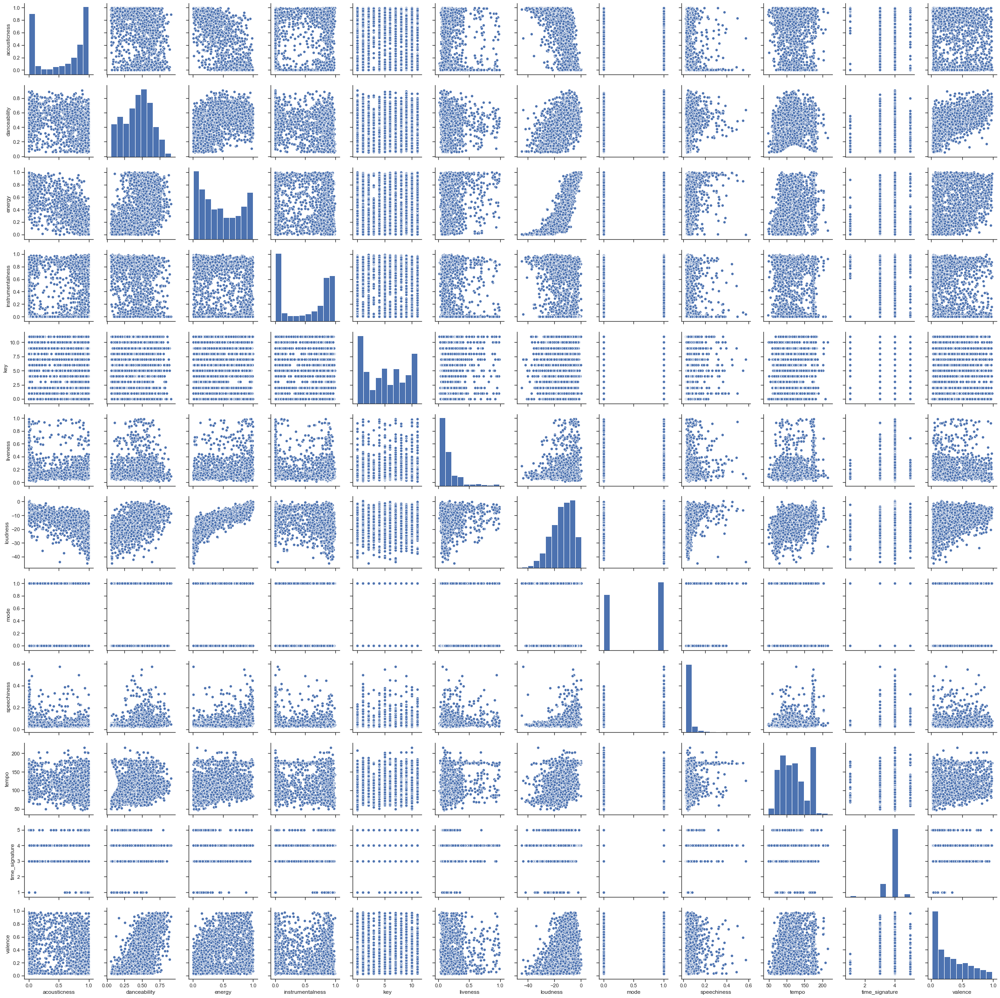

In [15]:
sns.set(style="ticks")
sns.pairplot(audio_features);

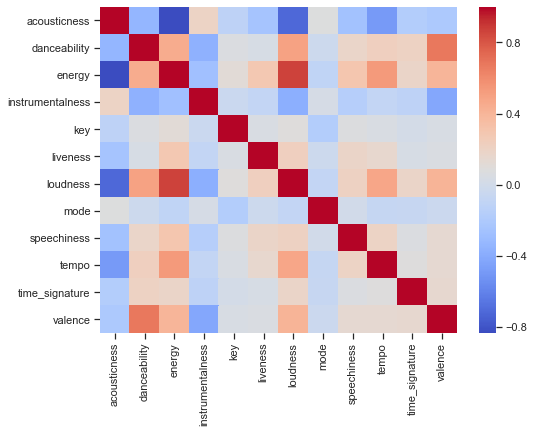

In [50]:
sns.heatmap(audio_features.corr(), cmap='coolwarm')

Energy y Acousticness están fuertemente correlacionadas negativamente, y Energy y Loudness fuertemente correlacionadas positivamente. Posiblemente a la hora de hacer un cluster habrá que ver cuál eliminar, ya que dejar las 3 puede ser redudante e ineficiente. 

In [51]:
audio_features.std() / audio_features.mean()

acousticness        0.705926
danceability        0.441702
energy              0.732822
instrumentalness    0.767371
key                 0.671846
liveness            0.905357
loudness           -0.579437
mode                0.904159
speechiness         0.886107
tempo               0.302209
time_signature      0.140114
valence             0.827934
dtype: float64

A priori tempo y time_signature parecieran ser las menos informativas por si solas.

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x1a3c1ab518>,
      dtype=object)

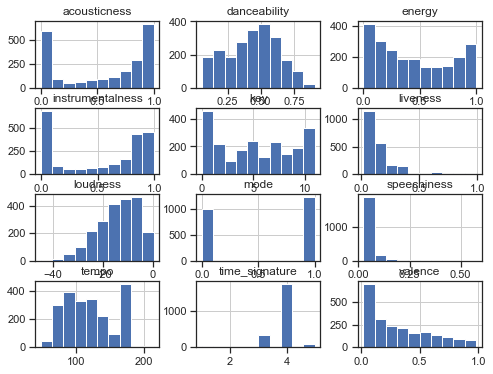

In [52]:
audio_features.hist()

In [53]:
# Estandarizo para graficar los box plots en una misma escala
ss = StandardScaler()
audio_features_norm = ss.fit_transform(audio_features)
audio_features_norm = pd.DataFrame(audio_features_norm, 
                                   columns=audio_features.columns, 
                                   index=audio_features.index)

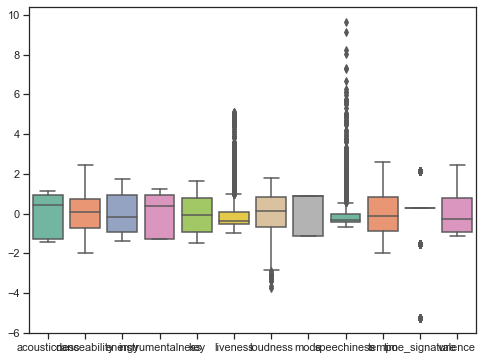

In [54]:
sns.boxplot(data=audio_features_norm, orient="v", palette="Set2")

Por supuesto, estandarizar las variables cambiaría en nada la correlación entre las mismas, con lo cual el heatmap y el scatter plot tendrían la misma forma

In [55]:
audio_features.describe()

,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence
count,2206.000000,2206.000000,2206.000000,2206.000000,2206.000000,2206.000000,2206.000000,2206.000000,2206.000000,2206.000000,2206.000000,2206.000000
mean,0.556379,0.437174,0.439957,0.508918,5.255666,0.175765,-14.134093,0.550317,0.060247,120.272359,3.836809,0.324883
std,0.392763,0.193100,0.322410,0.390529,3.530997,0.159130,8.189815,0.497575,0.053385,36.347364,0.537590,0.268982
min,0.000005,0.057000,0.000581,0.000000,0.000000,0.018500,-44.809000,0.000000,0.023400,47.382000,1.000000,0.019600
25%,0.061700,0.294250,0.140250,0.014000,2.000000,0.092200,-19.540000,0.000000,0.037125,89.156500,4.000000,0.078350
50%,0.718000,0.453000,0.383000,0.660000,5.000000,0.113000,-13.133000,1.000000,0.043900,115.696500,4.000000,0.252000
75%,0.923750,0.580000,0.748750,0.882000,8.000000,0.187750,-7.498250,1.000000,0.058300,149.970000,4.000000,0.529000
max,0.996000,0.909000,0.999000,0.994000,11.000000,0.987000,0.326000,1.000000,0.575000,214.744000,5.000000,0.981000


In [56]:
audio_features.time_signature[audio_features.time_signature == 1] # Esto esté mal probablemente

id
7IAFc5iQti2tzob7Uo7N1Y    1
7jXHtvJdsos3twI9tyCDu4    1
4UP1krmPc2VqQNmETlFJU1    1
1fIg2xMn1xYlmiRKGULcEy    1
5stPdVFNnyEahYLpWs2akd    1
0a9mUPCyu1R2kxRqDoO9Q3    1
05iURKvut2OWEzPHQUhDT5    1
3BO3R8SLyb9cfSCgk1kXUl    1
4zo9nVH8uBk5DnUa92ogWn    1
67l1U6nKf6zgwCV3AhObFa    1
1FHpgVtsaDeASGQyehjlzS    1
5zMuzsE5kvd54FwraufeeK    1
7nTwlmrw5dRthSvSTmCsKa    1
6vozhycIf8PgHWCO8013j1    1
4Bub8omJzWHwVmvRA4WtP3    1
6AbVJjzv7thIvmMCuhZrmK    1
2ZekRZ1vFLfQCaojN1AYEG    1
6H179fTdaQXT4QHnNxNX4D    1
15vbomdZhnUR4iXw2KK5M5    1
4NsPgRYUdHu2Q5JRNgXYU5    1
1AIu4EHzrN7GdpeKgigZ3G    1
5JDJv3Szs22nOTXE5YRRf5    1
6tQryZ48dDKVU4UypjXDXT    1
5Q5MFVjUWVNgb7XBerPdbQ    1
69eD0IfAqEIUnKX63Npksy    1
0jVy0Y3QEtUKsrIHAZuR45    1
5C0DGc7M86XqwMRPeusb8r    1
3qF9WLEnhK9cX5ol9sNut0    1
0G1Du52loFnqrRHQ7nUxqK    1
4w3bDJJwmlomeCOXT4oBr1    1
Name: time_signature, dtype: int64

## Análisis de Timbre

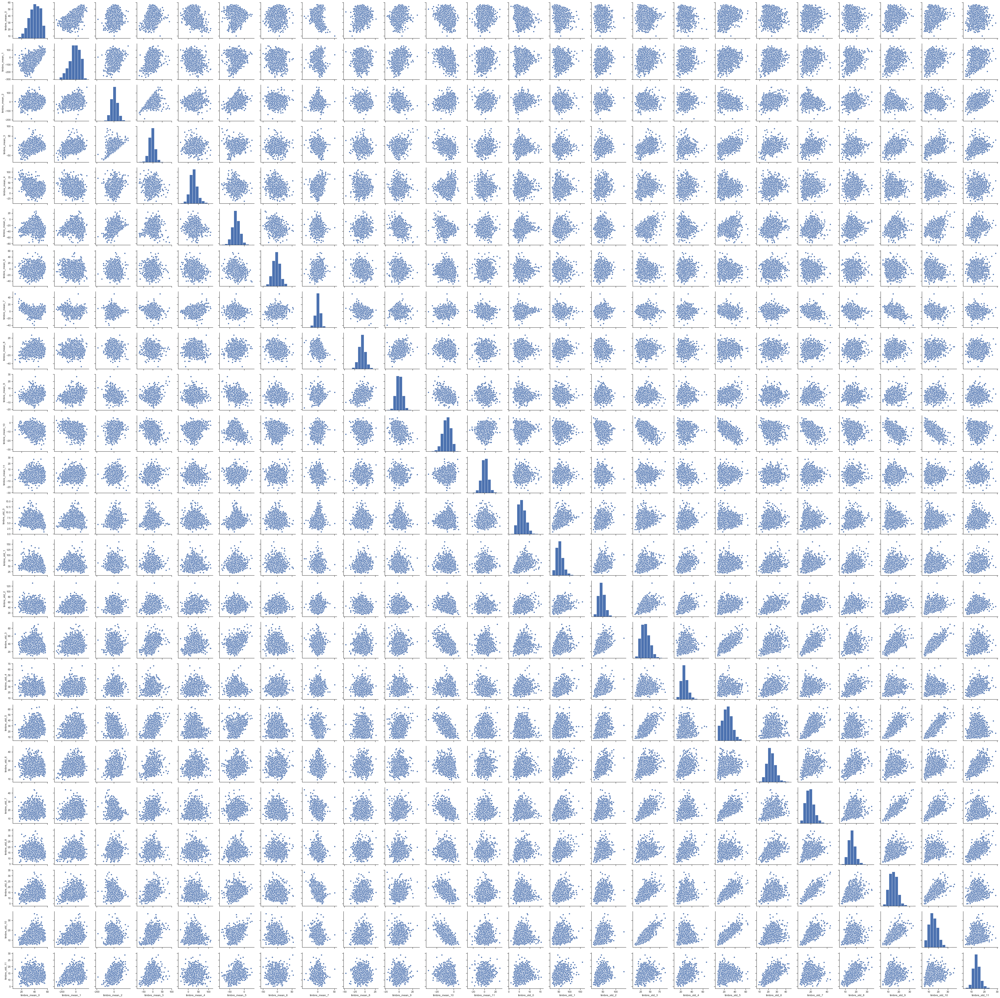

In [23]:
sns.pairplot(timbre);

In [57]:
timbre.std() / timbre.mean()

timbre_mean_0      0.208622
timbre_mean_1     -5.581919
timbre_mean_2     11.488894
timbre_mean_3     -3.459946
timbre_mean_4      0.719299
timbre_mean_5     -0.457310
timbre_mean_6     -3.946417
timbre_mean_7      8.273666
timbre_mean_8     -1.089375
timbre_mean_9     22.689914
timbre_mean_10    -0.567087
timbre_mean_11     6.671471
timbre_std_0       0.296840
timbre_std_1       0.299863
timbre_std_2       0.262176
timbre_std_3       0.310367
timbre_std_4       0.223011
timbre_std_5       0.361494
timbre_std_6       0.206213
timbre_std_7       0.265013
timbre_std_8       0.205481
timbre_std_9       0.255799
timbre_std_10      0.300568
timbre_std_11      0.202323
dtype: float64

En orden de importancia de mayor a menor tenemos: 
- timbre promedio en slot 9
- timbre promedio en slot 2
- timbre promedio en slot 7
- timbre promedio en slot 11
- timbre promedio en slot 1
- timbre promedio en slot 6
- timbre promedio en slot 3

Los desvíos estándar del timbre parecen aportar menos información a priori que los promedios


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x1a3ec10dd8>,
      dtype=object)

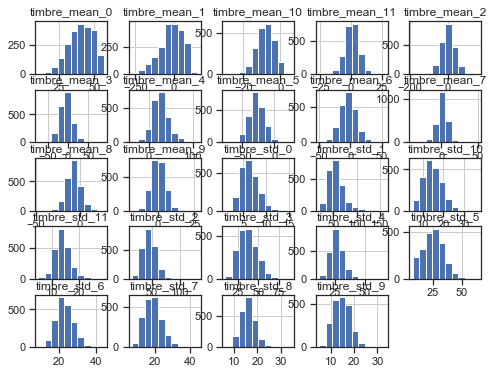

In [58]:
timbre.hist()

In [59]:
ss = StandardScaler()
timbre_norm = ss.fit_transform(timbre)
timbre_norm = pd.DataFrame(timbre_norm, 
                           columns=timbre.columns, 
                           index=timbre.index)

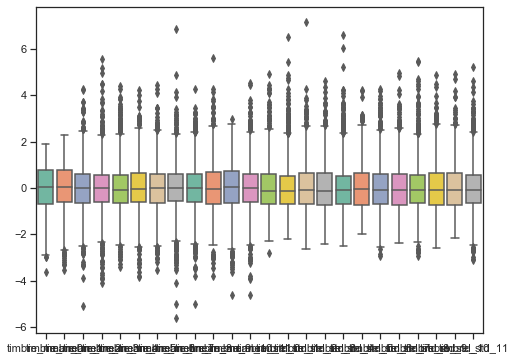

In [60]:
sns.boxplot(data=timbre_norm, orient="v", palette="Set2")

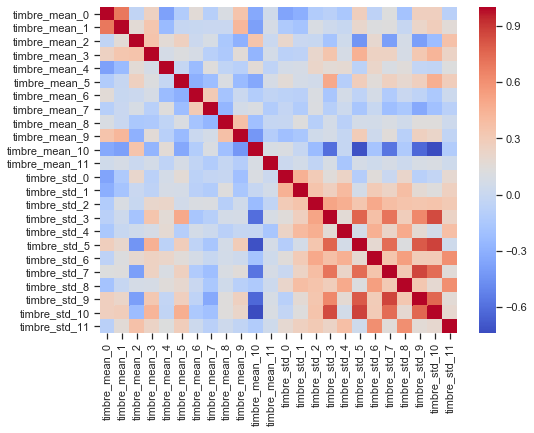

In [61]:
sns.heatmap(timbre.corr(), cmap='coolwarm')

Los desvíos estandar del timbre están en general positivamente correlacionados entre si, mientras que los promedios tienden a estar menos correlacionados entre ellos (excepto timbre 0 con timbre 1). Tambien vemos que el timbre_mean_10 esta fuertemente correlacionado negativamente con timbre_std_10 y timbre_std_5

## Análisis de Pitches

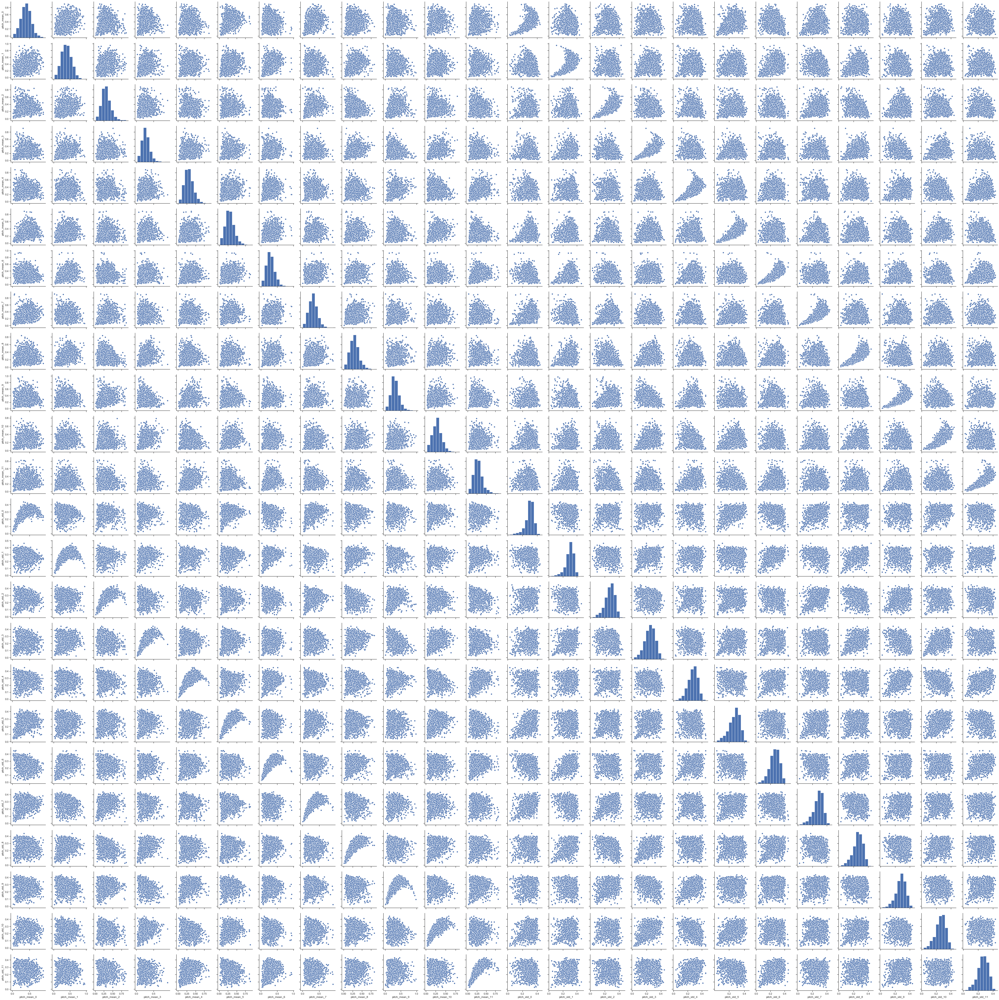

In [29]:
sns.pairplot(pitches)

In [62]:
pitches.std() / pitches.mean()

pitch_mean_0     0.377937
pitch_mean_1     0.393309
pitch_mean_2     0.413368
pitch_mean_3     0.427561
pitch_mean_4     0.413803
pitch_mean_5     0.421470
pitch_mean_6     0.421283
pitch_mean_7     0.404985
pitch_mean_8     0.418055
pitch_mean_9     0.414188
pitch_mean_10    0.415248
pitch_mean_11    0.423765
pitch_std_0      0.200443
pitch_std_1      0.207317
pitch_std_2      0.252095
pitch_std_3      0.295435
pitch_std_4      0.255634
pitch_std_5      0.269771
pitch_std_6      0.267977
pitch_std_7      0.247970
pitch_std_8      0.266264
pitch_std_9      0.242621
pitch_std_10     0.274178
pitch_std_11     0.266276
dtype: float64

En este caso los promedios en todos los slots tienen variabilidad similar, mayor que la variabilidad de los desvíos estandar (que también son similares entre sí)

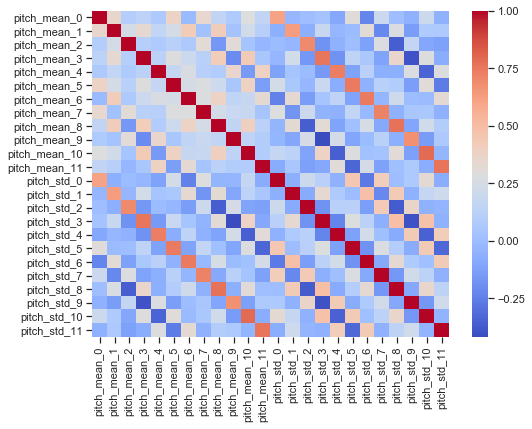

In [63]:
sns.heatmap(pitches.corr(), cmap='coolwarm')

Vemos acá que las medias y los desvios estandares de un mismo slot estan correlacionados positivamente

In [64]:
ss = StandardScaler()
pitches_norm = ss.fit_transform(pitches)
pitches_norm = pd.DataFrame(pitches_norm, 
                           columns=pitches.columns, 
                           index=pitches.index)

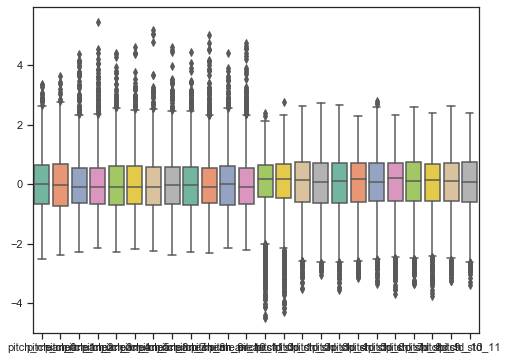

In [65]:
sns.boxplot(data=pitches_norm, orient="v", palette="Set2")

## Clustering Jerárquico

In [34]:
# Uno audio_features, timbre y pitches en un solo dataframe
df_audio = pd.merge(audio_features_norm, timbre_norm, left_index=True, right_index=True)
df_audio = pd.merge(df_audio, pitches_norm, left_index=True, right_index=True)

In [35]:
df_audio.shape

(2205, 60)